**Inicialmente importamos la librerias necesarias para el análisis de datos**

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns


**A continuación cargamos el archivo CSV para realizar el análisis de la limpieza de los datos**

In [6]:
df = pd.read_csv('/content/sample_data/Emergencias_UNGRD._20251123.csv', sep=',')

/tmp/ipython-input-2137831665.py:1: DtypeWarning: Columns (37,56,60,66) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('/content/sample_data/Emergencias_UNGRD._20251123.csv', sep=',')


In [7]:
display(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25857 entries, 0 to 25856
Data columns (total 71 columns):
 #   Column                                                 Non-Null Count  Dtype 
---  ------                                                 --------------  ----- 
 0   FECHA                                                  25857 non-null  object
 1   DEPARTAMENTO                                           25857 non-null  object
 2   MUNICIPIO                                              25857 non-null  object
 3   EVENTO                                                 25857 non-null  object
 4   DIVIPOLA                                               25857 non-null  object
 5   FALLECIDOS                                             25857 non-null  int64 
 6   HERIDOS                                                25857 non-null  int64 
 7   DESAPARECIDOS                                          25857 non-null  int64 
 8   PERSONAS                                               2

None

**Ahora importamos la herramienta pandas profiling para el análisis inicial de los datos**

In [8]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     \ 17.9 MB 31.2 MB/s 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 67.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 45.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.1 MB/s eta 0:00:00
  Created wheel for ydata-profiling: filename=ydata_profiling-0.0.dev0-py2.py3-none-any.whl size=398767 sha256=9f705c5dbd8638056e9c674b20fb50ae1d043c88104946f97bd9b80a240bb449
  Stored in directory: /tmp/pip-ephem-wheel-cache-y3tte6e6/wheels/71/3c/c6/1dde962797c52d907d477fe1b35111dccb8c4574b0ad7a8cb7
Successfully built ydata-profiling


In [9]:
import pandas_profiling as pp

/tmp/ipython-input-1872674328.py:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling as pp


In [10]:
from pandas_profiling import ProfileReport

In [11]:
from ydata_profiling import ProfileReport

ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 71/71 [00:06<00:00, 11.30it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

**Una vez analizada la información básica con pandas profiling proveemos a la limpieza de la data Utilizando la librería de pandas**

Eliminamos Las filas o columnas con vacias.

In [12]:
df.dropna(inplace=True)

Eliminamos los registros duplicados

In [13]:

df.drop_duplicates(inplace=True)


**Ahora validamos las culpas que deberían ser Valores cuantitativos Y los convertimos en valores Acorde Para ver cuondores que no pueden ser convertidos Agregar en la mediana**

In [14]:

columnas_conteo = ['FALLECIDOS', 'HERIDOS', 'DESAPARECIDOS', 'PERSONAS', 'FAMILIAS', 'VIVIENDAS DESTRUIDAS', 'VIVIENDAS AVERIADAS']

for col in columnas_conteo:

    df[col] = pd.to_numeric(df[col], errors='coerce')


for col in columnas_conteo:
    mediana_val = df[col].median()
    df[col].fillna(mediana_val, inplace=True)

print("Valores nulos en FALLECIDOS después de imputación:", df['FALLECIDOS'].isnull().sum())

Valores nulos en FALLECIDOS después de imputación: 0


/tmp/ipython-input-1096409016.py:10: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(mediana_val, inplace=True)


**Conversion a formato fecha datetime**

In [15]:

df['FECHA'] = pd.to_datetime(df['FECHA'], format='%Y %b %d %I:%M:%S %p', errors='coerce')



**tratamiento de datos atípicos**

In [16]:
columna_atipicos = 'FALLECIDOS'


Q1 = df[columna_atipicos].quantile(0.25)
Q3 = df[columna_atipicos].quantile(0.75)
IQR = Q3 - Q1

limite_superior = Q3 + 1.5 * IQR

df[columna_atipicos] = df[columna_atipicos].clip(upper=limite_superior)


**Estandarización de código divipola**

In [17]:

df['DIVIPOLA_Limpia'] = df['DIVIPOLA'].astype(str).str.replace(',', '', regex=False)


df['DIVIPOLA_Limpia'] = pd.to_numeric(df['DIVIPOLA_Limpia'], errors='coerce', downcast='integer')


print(df['DIVIPOLA_Limpia'].head())

0     5656
1    66440
2     5044
3     5467
4     5154
Name: DIVIPOLA_Limpia, dtype: int32


**Validamos los datos nuevamente**

In [18]:
display(df.info())

<class 'pandas.core.frame.DataFrame'>
Index: 22020 entries, 0 to 25856
Data columns (total 72 columns):
 #   Column                                                 Non-Null Count  Dtype         
---  ------                                                 --------------  -----         
 0   FECHA                                                  22020 non-null  datetime64[ns]
 1   DEPARTAMENTO                                           22020 non-null  object        
 2   MUNICIPIO                                              22020 non-null  object        
 3   EVENTO                                                 22020 non-null  object        
 4   DIVIPOLA                                               22020 non-null  object        
 5   FALLECIDOS                                             22020 non-null  int64         
 6   HERIDOS                                                22020 non-null  int64         
 7   DESAPARECIDOS                                          22020 non-null  i

None

**Normalización de datos**

In [19]:



columnas_a_convertir = [
    'HECTAREAS', 'SUBSIDIO DE ARRIENDO', 'ASISTENCIA NO ALIMENTARIA', 'APOYO ALIMENTARIO',
    'MATERIALES CONSTRUCCION', 'SACOS - BIGBAG', 'OBRAS DE EMERGENCIA',
    'CARROTANQUES - MOTOBOMBAS-PLANTA POTABILIZADORA', 'HORAS MAQUINA\nRETROEXCAVADORA\nBULLDOCER\nINTERVENTORIA',
    'APOYO AEREO / TERRESTRE', 'FIC / TRANSFERENCIAS ECONOMICAS', 'INFRAESCTRUCTURA TECNOLOGICA',
    'RECURSOS EJECUTADOS', 'OTROS', 'CANTIDAD KIT DE ALIMENTO', 'VALOR KIT DE ALIMENTO',
    'CANTIDAD RACIONES DE CAMPAÑA', 'VALOR RACIONES DE CAMPAÑA', 'CANTIDAD KIT ASEO',
    'VALOR KIT ASEO', 'CANTIDAD KIT COCINA', 'VALOR KIT COCINA', 'CANTIDAD COLCHONETA',
    'VALOR COLCHONETA', 'CANTIDAD FRAZADAS/\nSOBRECAMAS', 'VALOR FRAZADAS/\nSOBRECAMAS',
    'CANTIDAD SABANAS / COBIJA SENCILLA', 'VALOR SABANAS / COBIJA SENCILLA',
    'CANTIDAD HAMACAS', 'VALOR HAMACAS', 'CANTIDAD TOLDILLOS', 'VALOR TOLDILLOS',
    'CANTIDAD CARPAS', 'VALOR CARPAS', 'VALOR TOTAL ASISTENCIA NO ALIMENTARIA',
    'CANTIDAD PLASTICO NEGRO', 'VALOR PLASTICO NEGRO', 'CANTIDAD SACOS', 'VALOR SACOS',
    'CANTIDAD BIG BAG', 'VALOR BIG BAG', 'CANTIDAD CEMENTO', 'VALOR CEMENTO',
    'CANTIDAD TEJAS DE ZINC', 'VALOR TEJAS DE ZINC', 'CANTIDAD TEJAS DE FIBROCEMENTO',
    'VALOR TEJAS DE FIBROCEMENTO', 'VALOR MATERIALES DE CONSTRUCCION',
    'VALOR TOTAL  APOYO DEL FNGRD'
]

def clean_and_convert_to_float(df, columns):
    for col in columns:

        df[col] = df[col].astype(str).str.replace(r'[$,]', '', regex=True)
        df[col] = pd.to_numeric(df[col], errors='coerce') # 'coerce' convierte errores a NaN
    return df

df = clean_and_convert_to_float(df, columnas_a_convertir)

print("Tipos de datos después de la conversión:")
print(df[columnas_a_convertir].dtypes)

df[columnas_a_convertir] = df[columnas_a_convertir].fillna(0)

columnas_numericas = df.select_dtypes(include=np.number).columns.tolist()

columnas_a_excluir = ['DIVIPOLA_Limpia']
columnas_para_normalizar = [col for col in columnas_numericas if col not in columnas_a_excluir]

print("\nColumnas que serán normalizadas:", columnas_para_normalizar)

scaler = MinMaxScaler()

df_normalizado = df.copy()

df_normalizado[columnas_para_normalizar] = scaler.fit_transform(df_normalizado[columnas_para_normalizar])

print("\n--- Resultado de la Normalización ---")
print(df_normalizado[columnas_para_normalizar].head())

print("\nVerificación de Rangos (Deberían estar entre 0 y 1):")
print(df_normalizado[columnas_para_normalizar].min().min())
print(df_normalizado[columnas_para_normalizar].max().max())

Tipos de datos después de la conversión:
HECTAREAS                                                   float64
SUBSIDIO DE ARRIENDO                                        float64
ASISTENCIA NO ALIMENTARIA                                   float64
APOYO ALIMENTARIO                                           float64
MATERIALES CONSTRUCCION                                     float64
SACOS - BIGBAG                                              float64
OBRAS DE EMERGENCIA                                         float64
CARROTANQUES - MOTOBOMBAS-PLANTA POTABILIZADORA             float64
HORAS MAQUINA\nRETROEXCAVADORA\nBULLDOCER\nINTERVENTORIA    float64
APOYO AEREO / TERRESTRE                                     float64
FIC / TRANSFERENCIAS ECONOMICAS                             float64
INFRAESCTRUCTURA TECNOLOGICA                                float64
RECURSOS EJECUTADOS                                         float64
OTROS                                                       float64
CANTIDA

**Se verifica la normalización de la data**

In [20]:
df_normalizado.info()

<class 'pandas.core.frame.DataFrame'>
Index: 22020 entries, 0 to 25856
Data columns (total 72 columns):
 #   Column                                                 Non-Null Count  Dtype         
---  ------                                                 --------------  -----         
 0   FECHA                                                  22020 non-null  datetime64[ns]
 1   DEPARTAMENTO                                           22020 non-null  object        
 2   MUNICIPIO                                              22020 non-null  object        
 3   EVENTO                                                 22020 non-null  object        
 4   DIVIPOLA                                               22020 non-null  object        
 5   FALLECIDOS                                             22020 non-null  float64       
 6   HERIDOS                                                22020 non-null  float64       
 7   DESAPARECIDOS                                          22020 non-null  f

/tmp/ipython-input-2646272856.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_normalizado[df_normalizado['DEPARTAMENTO'].isin(top_10_departamentos)],


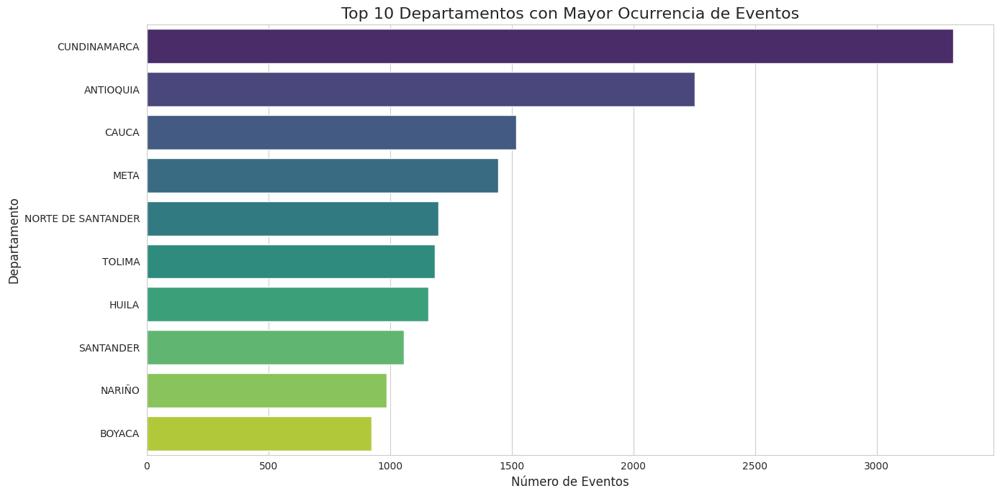

/tmp/ipython-input-2646272856.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_normalizado[df_normalizado['MUNICIPIO'].isin(top_10_municipios)],


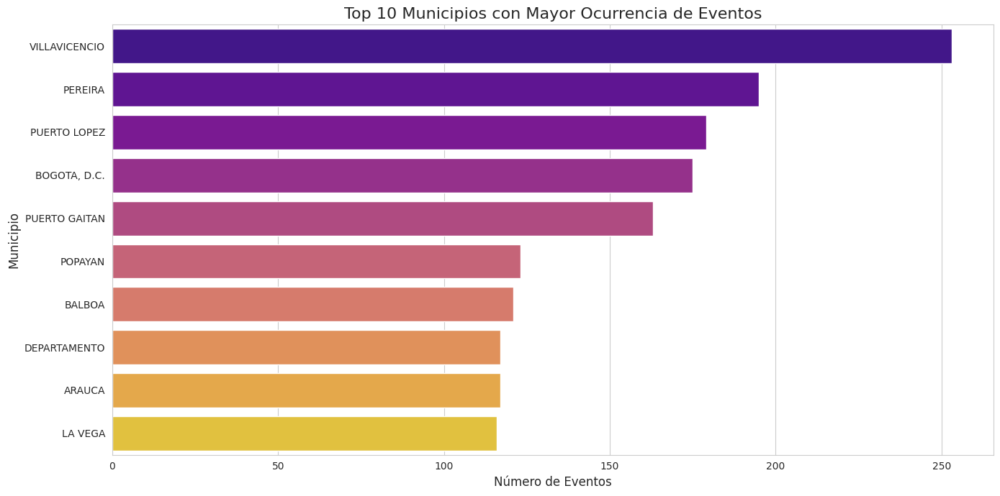

/tmp/ipython-input-2646272856.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=departamento_proportions.values,


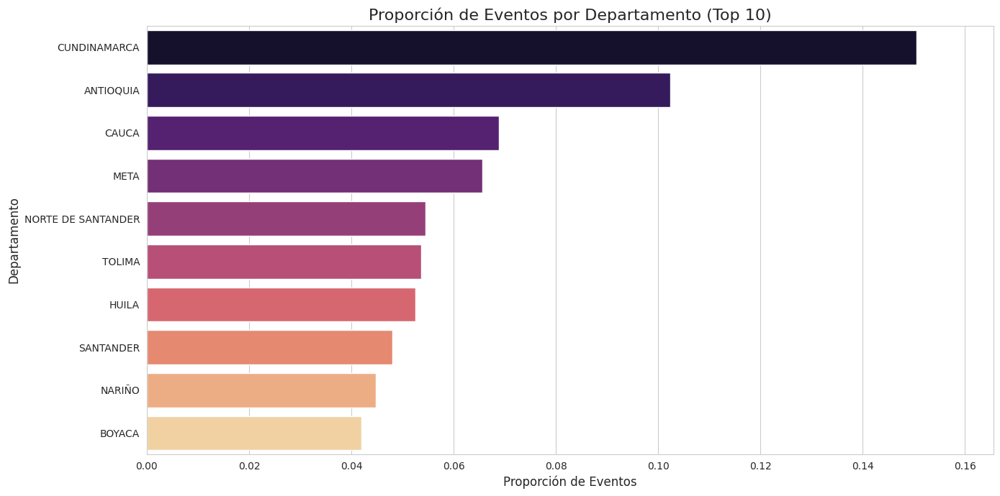


Tipos de EVENTO únicos:
EVENTO
INCENDIO DE COBERTURA VEGETAL    6512
MOVIMIENTO EN MASA               5011
INUNDACION                       3823
VENDAVAL                         1523
INCENDIO ESTRUCTURAL             1299
Name: count, dtype: int64

Analizando el evento más común: 'INCENDIO DE COBERTURA VEGETAL' por Departamento


/tmp/ipython-input-2646272856.py:56: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=conteo_evento_depto.values,


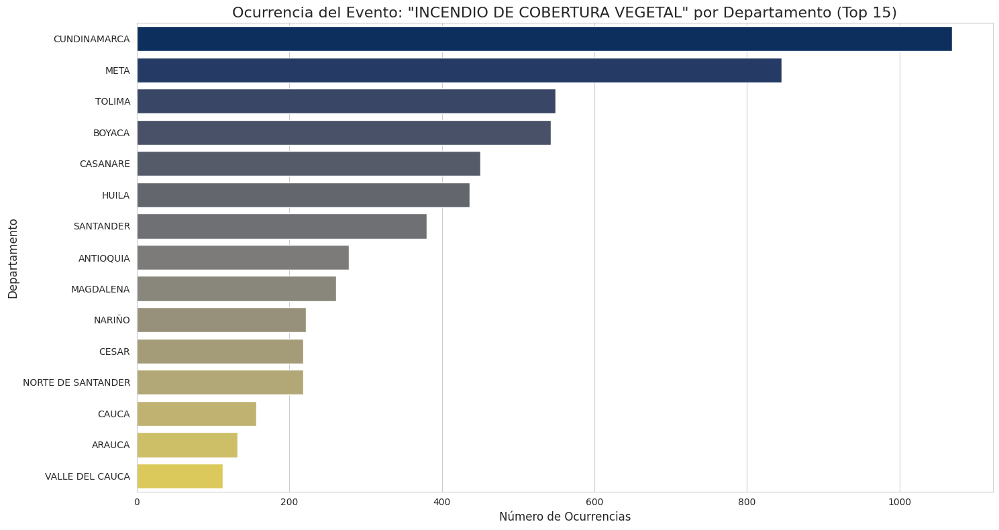

In [21]:
sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (1, 4)

# Top 10 Departamentos con Mayor Ocurrencia de Eventos
plt.figure(figsize=(14, 7))
# Contar ocurrencias y seleccionar los 10 principales
top_10_departamentos = df_normalizado['DEPARTAMENTO'].value_counts().nlargest(10).index
sns.countplot(data=df_normalizado[df_normalizado['DEPARTAMENTO'].isin(top_10_departamentos)],
              y='DEPARTAMENTO',
              order=top_10_departamentos,
              palette='viridis')
plt.title('Top 10 Departamentos con Mayor Ocurrencia de Eventos', fontsize=16)
plt.xlabel('Número de Eventos', fontsize=12)
plt.ylabel('Departamento', fontsize=12)
plt.tight_layout()
plt.show()

# Top 10 Municipios con Mayor Ocurrencia
plt.figure(figsize=(14, 7))
top_10_municipios = df_normalizado['MUNICIPIO'].value_counts().nlargest(10).index
sns.countplot(data=df_normalizado[df_normalizado['MUNICIPIO'].isin(top_10_municipios)],
              y='MUNICIPIO',
              order=top_10_municipios,
              palette='plasma')
plt.title('Top 10 Municipios con Mayor Ocurrencia de Eventos', fontsize=16)
plt.xlabel('Número de Eventos', fontsize=12)
plt.ylabel('Municipio', fontsize=12)
plt.tight_layout()
plt.show()

#eventos por departamento
plt.figure(figsize=(14, 7))

departamento_proportions = df_normalizado['DEPARTAMENTO'].value_counts(normalize=True).nlargest(10)
sns.barplot(x=departamento_proportions.values,
            y=departamento_proportions.index,
            palette='magma')
plt.title('Proporción de Eventos por Departamento (Top 10)', fontsize=16)
plt.xlabel('Proporción de Eventos', fontsize=12)
plt.ylabel('Departamento', fontsize=12)
plt.xlim(0, departamento_proportions.max() * 1.1)
plt.tight_layout()
plt.show()


print("\nTipos de EVENTO únicos:")
print(df['EVENTO'].value_counts().head())

#evento mas común
evento_mas_comun = df_normalizado['EVENTO'].value_counts().index[0]
print(f"\nAnalizando el evento más común: '{evento_mas_comun}' por Departamento")

plt.figure(figsize=(15, 8))

conteo_evento_depto = df_normalizado[df_normalizado['EVENTO'] == evento_mas_comun]['DEPARTAMENTO'].value_counts().nlargest(15)
sns.barplot(x=conteo_evento_depto.values,
            y=conteo_evento_depto.index,
            palette='cividis')
plt.title(f'Ocurrencia del Evento: "{evento_mas_comun}" por Departamento (Top 15)', fontsize=16)
plt.xlabel('Número de Ocurrencias', fontsize=12)
plt.ylabel('Departamento', fontsize=12)
plt.tight_layout()
plt.show()

In [22]:
df_normalizado.to_csv('emergencias.csv', index=False)